<a href="https://colab.research.google.com/github/Abhishek3102/OpenCV/blob/main/Image_Relighting.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Mount Google Drive to Colab.

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


Import Libraries.

In [ ]:
import os
import cv2
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression

%matplotlib inline

## Part 1: Camera Radiometric Calibration

Check image files.

In [ ]:
!ls '/content/drive/MyDrive/CSE264-CV/1/'

100.jpg  13.jpg  160.jpg  20.jpg   25.jpg  40.jpg  60.jpg
10.jpg	 15.jpg  200.jpg  250.jpg  30.jpg  50.jpg  80.jpg


Set image directory.

In [ ]:
image_dir = '/content/drive/MyDrive/CSE264-CV/1/'

Load images from the image driectory.

In [ ]:
def load_images_from_folder(folder):
  images = []
  image_list = []

  for x in os.listdir(folder):
    image_list.append((int)(x.split('.')[0]))

  image_list.sort()

  for filename in image_list:
    img_path = os.path.join(folder,str(filename)) + '.jpg'
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    if img is not None:
      images.append(img)

  return images, image_list

In [ ]:
images, image_list = load_images_from_folder(image_dir)

Sort images by the exposure time.

In [ ]:
print("Number of images:", len(images))
print("Image list:", image_list)

Number of images: 14
Image list: [10, 13, 15, 20, 25, 30, 40, 50, 60, 80, 100, 160, 200, 250]


Crop images at the center into a shape of 100x100 pixels.

In [ ]:
def crop_images(images, width = 100, height = 100):
  cropped = []

  for img in images:
    x = img.shape[0]
    y = img.shape[1]
    x = x/2 - width/2
    y = y/2 - height/2

    crop_img = img[int(y):int(y+height), int(x):int(x+width), :]
    cropped.append(crop_img)

  return cropped

In [ ]:
cropped_images = crop_images(images)

In [ ]:
print("The shape of cropped images:", cropped_images[0].shape)

The shape of cropped images: (100, 100, 3)


Visualize cropped images.

In [ ]:
def plot_images(images):
  fig, axes = plt.subplots(1, len(images), constrained_layout=True, figsize=(50,20))

  for i,img in enumerate(images):
    axes[i].imshow(img)
    axes[i].axis('off')
    axes[i].title.set_text('T=1/' + str(image_list[i]) + 's')

  plt.show()

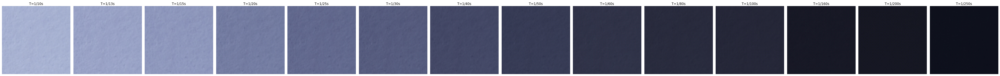

In [ ]:
plot_images(cropped_images)

Compute 1/T (i.e. 1/F = T).

In [ ]:
T = image_list[::-1]

print("T:", T)

for i in range(len(T)):
  T[i] = round(1/T[i], 3)

print("1/T:", T)

T: [250, 200, 160, 100, 80, 60, 50, 40, 30, 25, 20, 15, 13, 10]
1/T: [0.004, 0.005, 0.006, 0.01, 0.013, 0.017, 0.02, 0.025, 0.033, 0.04, 0.05, 0.067, 0.077, 0.1]


Compute average of the cropped center images (for each channel).

In [ ]:
def get_average_B_dash(images):
  red, green, blue = [], [], []

  for img in images:
    red.append(np.average(img[:,:,0]))
    green.append(np.average(img[:,:,1]))
    blue.append(np.average(img[:,:,2]))

  return red, green, blue

In [ ]:
B_dash_r, B_dash_g, B_dash_b = get_average_B_dash(cropped_images)

In [ ]:
B_dash_r.reverse()
B_dash_g.reverse()
B_dash_b.reverse()

print("Computed average B' list for red channel:", B_dash_r)

Computed average B' list for red channel: [14.3174, 22.0918, 23.5682, 37.3809, 40.9078, 48.1145, 54.9806, 67.7494, 85.8274, 97.9872, 115.8167, 142.0358, 153.1511, 167.3421]


Visualize B' vs T for each channel.

In [ ]:
def plot_B(T, B_dash):
  fig, axes = plt.subplots(1, 3, constrained_layout=True, figsize=(20,5))
  color = ['red', 'green', 'blue']

  for i, b_dash in enumerate(B_dash):
    axes[i].plot(T, b_dash, marker='o', color=color[i])
    axes[i].set_xlabel("Time (s)")
    axes[i].set_ylabel("B' for " + color[i] + " channel")
    axes[i].title.set_text("B' vs T for " + color[i] + " channel")

  plt.show()

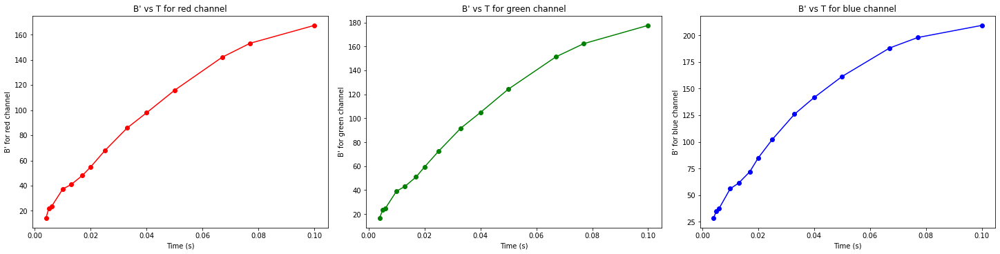

In [ ]:
plot_B(T, [B_dash_r, B_dash_g, B_dash_b])

Function B = $f^{-1}$(B').

In [ ]:
def g(B_dash, T, B_dash_j):
  if B_dash < B_dash_j[0]:
    output_T = (B_dash * T[0]) / B_dash_j[0]
  elif B_dash > B_dash_j[-1]:
    output_T = (((B_dash - B_dash_j[-2]) * (T[-1] - T[-2])) / (B_dash_j[-1] - B_dash_j[-2])) + T[-2]
  else:
    for i in range(len(B_dash_j)-1):
      if (B_dash_j[i] < B_dash and B_dash <= B_dash_j[i+1]):
        output_T = (B_dash - B_dash_j[i]) * ((T[i+1] - T[i]) / (B_dash_j[i+1] - B_dash_j[i])) + T[i]
        break

  return output_T

def f_inv(B_dash, T_i, B_dash_j, alpha):
  T = g(B_dash, T_i, B_dash_j)
  B = alpha * T
  return B

In [ ]:
alpha_r = 255.0 / g(255, T, B_dash_r)
alpha_g = 255.0 / g(255, T, B_dash_g)
alpha_b = 255.0 / g(255, T, B_dash_b)

In [ ]:
print("Alpha values for channels r, g and b:", alpha_r, alpha_g, alpha_b)

Alpha values for channels r, g and b: 1053.4092940514013 1176.52809426401 1331.0299512645925


Visualize B' vs B for each channel.

In [ ]:
def plot_B_B_dash(B_dash, B):
  fig, axes = plt.subplots(1, 3, constrained_layout=True, figsize=(20,5))
  color = ['red', 'green', 'blue']

  for i, b in enumerate(B):
    axes[i].plot(B_dash, b, marker='o', color=color[i])
    axes[i].set_xlabel("B'")
    axes[i].set_ylabel("B for " + color[i] + " channel")
    axes[i].title.set_text("B' vs B for " + color[i] + " channel")

  plt.show()

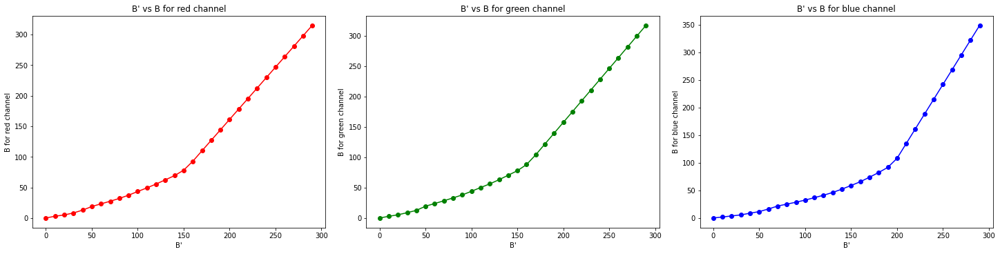

In [ ]:
B_dash = list(range(0, 300, 10))

B_r = [f_inv(b, T, B_dash_r, alpha_r) for b in B_dash]
B_g = [f_inv(b, T, B_dash_g, alpha_g) for b in B_dash]
B_b = [f_inv(b, T, B_dash_b, alpha_b) for b in B_dash]

plot_B_B_dash(B_dash, [B_r, B_g, B_b])

## Part 2: Acquire a Picture Stack.

Check image files.

In [ ]:
!ls '/content/drive/MyDrive/CSE264-CV/2/'

Set image directory.

In [ ]:
image_dir = '/content/drive/MyDrive/CSE264-CV/2/'

Load image files from image directory.

In [ ]:
def load_images_from_folder(folder):
  images = []
  image_list = []

  for x in os.listdir(folder):
    image_list.append((int)(x.split('.')[0]))

  image_list.sort()

  for filename in image_list:
    img_path = os.path.join(folder,str(filename)) + '.jpg'
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    if img is not None:
      images.append(img)

  return images, image_list

In [ ]:
images, image_list = load_images_from_folder(image_dir)

In [ ]:
print("Image shape:", images[0].shape)

Image shape: (1920, 1440, 3)


In [ ]:
# images.reverse()
print("Number of images:", len(images))
print("Image list:", image_list)

Number of images: 25
Image list: [10, 11, 13, 15, 20, 25, 30, 40, 50, 80, 90, 100, 160, 200, 250, 500, 800, 1250, 1500, 1600, 2000, 2500, 3200, 5000, 6400]


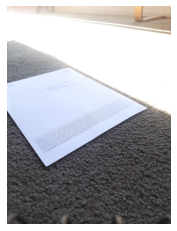

In [ ]:
plt.axis('off')
plt.imshow(images[0])

Function B = $f^{-1}$(B').

In [ ]:
def g(B_dash, T, B_dash_j):
  if B_dash < B_dash_j[0]:
    output_T = (B_dash * T[0]) / B_dash_j[0]
  elif B_dash > B_dash_j[-1]:
    output_T = (((B_dash - B_dash_j[-2]) * (T[-1] - T[-2])) / (B_dash_j[-1] - B_dash_j[-2])) + T[-2]
  else:
    for i in range(len(B_dash_j)-1):
      if (B_dash_j[i] < B_dash and B_dash <= B_dash_j[i+1]):
        output_T = (B_dash - B_dash_j[i]) * ((T[i+1] - T[i]) / (B_dash_j[i+1] - B_dash_j[i])) + T[i]
        break

  return output_T

def f_inv(B_dash, T_i, B_dash_j, alpha):
  T = g(B_dash, T_i, B_dash_j)
  B = alpha * T
  return B

In [ ]:
alpha_r = 255.0 / g(255, T, B_dash_r)
alpha_g = 255.0 / g(255, T, B_dash_g)
alpha_b = 255.0 / g(255, T, B_dash_b)

In [ ]:
print("Alpha values for channels r, g and b:", alpha_r, alpha_g, alpha_b)

Alpha values for channels r, g and b: 1053.4092940514013 1176.52809426401 1331.0299512645925


Set linearized image directory.

In [ ]:
linearized_images_dir = '/content/drive/MyDrive/CSE264-CV/Linearized-Images/'

Linearize images.

NOTE: *It takes some time to linearize all the images, skip to next step to load the preprocessed linearized images.*

In [ ]:
def linearize(image):
  img = image.copy()

  for i in range(image.shape[0]):
    for j in range(image.shape[1]):
      img[i][j][0] = f_inv(image[i][j][0], T, B_dash_r, alpha_r)
      img[i][j][1] = f_inv(image[i][j][1], T, B_dash_g, alpha_g)
      img[i][j][2] = f_inv(image[i][j][2], T, B_dash_b, alpha_b)

  return img

In [ ]:
linearized_images = []
i = 0

for image in tqdm(images):
  linearized_image = linearize(image)
  linearized_images.append(linearized_image)

  image_name = os.path.join(linearized_images_dir, (str(image_list[i]) + '.jpg'))
  cv2.imwrite(image_name, linearized_image)
  i += 1

100%|██████████| 25/25 [40:23<00:00, 96.93s/it]


In [ ]:
image_dir = '/content/drive/MyDrive/CSE264-CV/2/'

Load linearized image files from the image directory.

NOTE: *It take some time to linearize all the images, so I preprocess them and save them to the google drive for future use.*

In [ ]:
def load_linearized_images_from_folder(folder):
  images = []
  image_list = []

  for x in os.listdir(folder):
    image_list.append((int)(x.split('.')[0]))

  image_list.sort()

  for filename in image_list:
    img_path = os.path.join(folder,str(filename)) + '.jpg'
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    if img is not None:
      images.append(img)

  return images, image_list

In [ ]:
linearized_images, linearized_image_list = load_linearized_images_from_folder(linearized_images_dir)

In [ ]:
print("Image shape:", linearized_images[0].shape)

Image shape: (1920, 1440, 3)


In [ ]:
print("Number of images:", len(linearized_images))
print("Image list:", linearized_image_list)

Number of images: 25
Image list: [10, 11, 13, 15, 20, 25, 30, 40, 50, 80, 90, 100, 160, 200, 250, 500, 800, 1250, 1500, 1600, 2000, 2500, 3200, 5000, 6400]


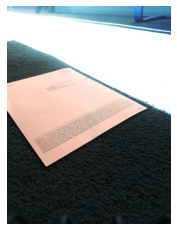

In [ ]:
plt.axis('off')
plt.imshow(linearized_images[0])

Plot original and linearized images.

In [ ]:
def plot_images(images, linearized_images):
  fig, axes = plt.subplots(len(images), 2, constrained_layout=True, figsize=(20,250))

  for i,img in enumerate(images):
    axes[i,0].imshow(img)
    axes[i,0].axis('off')
    axes[i,0].title.set_text("Original Image: T = 1/" + str(image_list[i]) + " (s)")

    axes[i,1].imshow(linearized_images[i])
    axes[i,1].axis('off')
    axes[i,1].title.set_text("Linearized Image: T = 1/" + str(image_list[i]) + " (s)")

  plt.axis('off')
  plt.show()

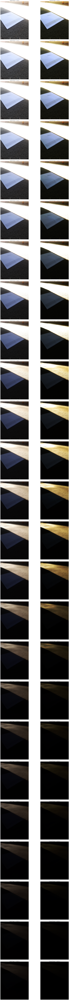

In [ ]:
plot_images(images, linearized_images)

Plot the normalized histogram for linearized images.

Image with T=1/50s is exposed to the right with about 2% (165,888) pixels of the total pixels being saturated.

In [ ]:
def plot_histogram(image):
  fig, axes = plt.subplots(1, 3, constrained_layout=True, figsize=(20,5))
  color = ['red', 'green', 'blue']

  for i in range(len(color)):
    axes[i].hist(image[:,:,i].ravel(), density=True, bins=51, color=color[i])
    axes[i].set_xlim([-0.5, 255.5])
    axes[i].set_xlabel("B")
    axes[i].set_ylabel("count (%) ")
    axes[i].title.set_text("Normalized histogram of " + color[i] + " channel")

  plt.show()

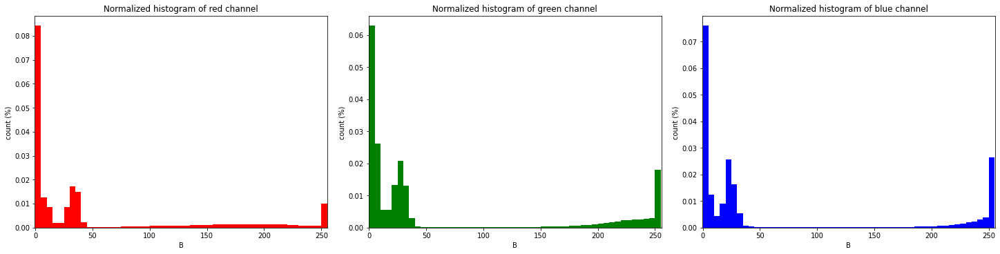

In [ ]:
plot_histogram(linearized_images[9])

## Part 3: Find the contrast value

Set linearized image directory.

In [ ]:
linearized_images_dir = '/content/drive/MyDrive/CSE264-CV/Linearized-Images/'

Load linearized image files from the image directory.

NOTE: *It take some time to linearize all the images, so I preprocess them and save them to the google drive for future use.*

In [ ]:
def load_linearized_images_from_folder(folder):
  images = []
  image_list = []

  for x in os.listdir(folder):
    image_list.append((int)(x.split('.')[0]))

  image_list.sort()

  for filename in image_list:
    img_path = os.path.join(folder,str(filename)) + '.jpg'
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    if img is not None:
      images.append(img)

  return images, image_list

In [ ]:
linearized_images, linearized_image_list = load_linearized_images_from_folder(linearized_images_dir)

In [ ]:
print("Image shape:", linearized_images[0].shape)

Image shape: (1920, 1440, 3)


In [ ]:
print("Number of images:", len(linearized_images))
print("Image list:", linearized_image_list)

Number of images: 25
Image list: [10, 11, 13, 15, 20, 25, 30, 40, 50, 80, 90, 100, 160, 200, 250, 500, 800, 1250, 1500, 1600, 2000, 2500, 3200, 5000, 6400]


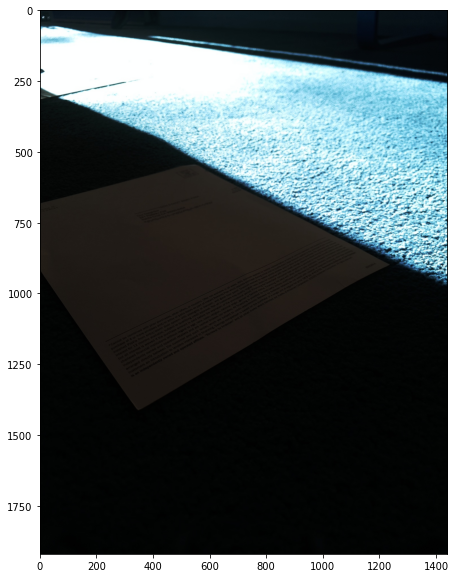

In [ ]:
plt.figure(figsize=(10,10))
plt.axis('off')
plt.title('The original image at T¯')
plt.imshow(linearized_images[9])

Crop images to get a shape of 100x100 pixels in the shade and in the sunlit area.

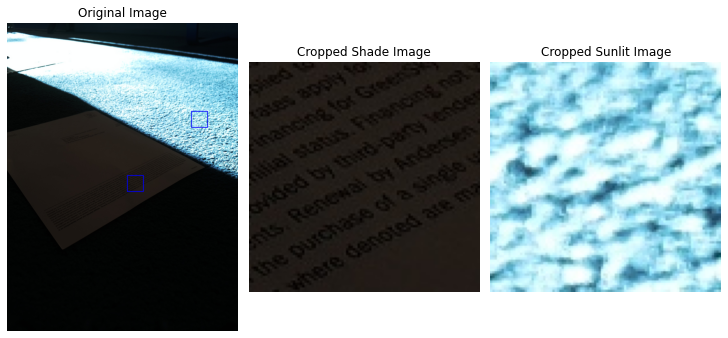

In [ ]:
img = linearized_images[9].copy()
h = w = 100

shade_x = 800 - w/2
shade_y = 1000 - h/2
crop_shade_img = img[int(shade_y):int(shade_y+h), int(shade_x):int(shade_x+w), :].copy()
cv2.rectangle(img, (int(shade_x),int(shade_y)), (int(shade_x+w),int(shade_y+h)), (0,0,255), 3)

sunlit_x = 1200 - w/2
sunlit_y = 600 - h/2
crop_sunlit_img = img[int(sunlit_y):int(sunlit_y+h), int(sunlit_x):int(sunlit_x+w), :].copy()
cv2.rectangle(img, (int(sunlit_x),int(sunlit_y)), (int(sunlit_x+w),int(sunlit_y+h)), (0,0,255), 3)

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, constrained_layout=True, figsize=(10,10))

ax1.imshow(img)
ax1.axis('off')
ax1.title.set_text("Original Image")

ax2.imshow(crop_shade_img)
ax2.axis('off')
ax2.title.set_text("Cropped Shade Image")

ax3.imshow(crop_sunlit_img)
ax3.axis('off')
ax3.title.set_text("Cropped Sunlit Image")

plt.show()

In [ ]:
def crop_shade_sunlit_images(images, width = 100, height = 100, shade_x = 800, shade_y = 1000, sunlit_x = 1200, sunlit_y = 600):
  cropped_shade = []
  cropped_sunlit = []

  for img in images:
    x = shade_x - width/2
    y = shade_y - height/2

    crop_img = img[int(y):int(y+height), int(x):int(x+width), :].copy()
    cropped_shade.append(crop_img)

    x = sunlit_x - width/2
    y = sunlit_y - height/2

    crop_img = img[int(y):int(y+height), int(x):int(x+width), :].copy()
    cropped_sunlit.append(crop_img)

  return cropped_shade, cropped_sunlit

In [ ]:
cropped_shade_images, cropped_sunlit_images = crop_shade_sunlit_images(linearized_images)

In [ ]:
print("The shape of shade cropped images:", cropped_shade_images[0].shape)
print("The shape of sunlit cropped images:", cropped_sunlit_images[0].shape)

The shape of shade cropped images: (100, 100, 3)
The shape of sunlit cropped images: (100, 100, 3)


Visualize cropped images.

In [ ]:
def plot_images(images):
  fig, axes = plt.subplots(1, len(images), constrained_layout=True, figsize=(50,20))

  for i,img in enumerate(images):
    axes[i].imshow(img)
    axes[i].axis('off')
    axes[i].title.set_text('T=1/' + str(linearized_image_list[i]) + 's')

  plt.show()

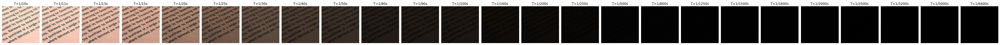

In [ ]:
plot_images(cropped_shade_images)

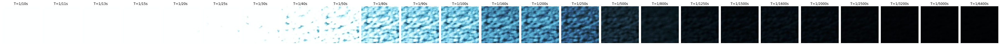

In [ ]:
plot_images(cropped_sunlit_images)

Compute 1/T.

In [ ]:
T = linearized_image_list[::-1]

print("T:", T)

for i in range(len(T)):
  T[i] = round(1/T[i], 5)

print("1/T:", T)

T: [6400, 5000, 3200, 2500, 2000, 1600, 1500, 1250, 800, 500, 250, 200, 160, 100, 90, 80, 50, 40, 30, 25, 20, 15, 13, 11, 10]
1/T: [0.00016, 0.0002, 0.00031, 0.0004, 0.0005, 0.00063, 0.00067, 0.0008, 0.00125, 0.002, 0.004, 0.005, 0.00625, 0.01, 0.01111, 0.0125, 0.02, 0.025, 0.03333, 0.04, 0.05, 0.06667, 0.07692, 0.09091, 0.1]


Compute average of the cropped center images (for each channel).

In [ ]:
def get_average_B(images):
  red, green, blue = [], [], []

  for img in images:
    red.append(np.average(img[:,:,0]))
    green.append(np.average(img[:,:,1]))
    blue.append(np.average(img[:,:,2]))

  return red, green, blue

In [ ]:
B_shade_r, B_shade_g, B_shade_b = get_average_B(cropped_shade_images)
B_sunlit_r, B_sunlit_g, B_sunlit_b = get_average_B(cropped_sunlit_images)

In [ ]:
B_shade_r.reverse()
B_shade_g.reverse()
B_shade_b.reverse()

B_sunlit_r.reverse()
B_sunlit_g.reverse()
B_sunlit_b.reverse()

print("Computed average B list for shade red channel:", B_shade_r)
print("Computed average B list for sunlit red channel:", B_sunlit_r)

Computed average B list for shade red channel: [0.0002, 0.0012, 0.645, 0.8688, 0.9845, 1.0608, 1.2749, 1.6704, 2.5423, 3.5082, 7.9349, 12.454, 15.1251, 24.6257, 27.0714, 30.271, 49.2606, 61.8572, 82.4261, 104.1565, 138.3209, 180.7299, 197.9552, 211.5671, 216.3251]
Computed average B list for sunlit red channel: [1.9276, 2.1438, 2.7645, 3.3111, 4.8903, 6.0621, 4.9201, 6.8963, 11.8647, 21.3374, 45.2945, 68.0499, 71.0, 122.5141, 144.5335, 168.2665, 237.6443, 246.7213, 253.0461, 253.7959, 253.953, 254.0, 254.0, 254.0, 254.0]


Filter out saturated images.

In [ ]:
idx = 10

B_shade_r = B_shade_r[:idx]
B_shade_g = B_shade_g[:idx]
B_shade_b = B_shade_b[:idx]
B_sunlit_r = B_sunlit_r[:idx]
B_sunlit_g = B_sunlit_g[:idx]
B_sunlit_b = B_sunlit_b[:idx]

T = T[:idx]

Perform linear regression.

In [ ]:
def perform_linear_regression(x, y):
  x = np.array(x).reshape((-1,1))

  model = LinearRegression().fit(x, y)
  y_pred = model.predict(x)

  return y_pred

In [ ]:
y_shade_r = perform_linear_regression(T, B_shade_r)
y_shade_g = perform_linear_regression(T, B_shade_g)
y_shade_b = perform_linear_regression(T, B_shade_b)

y_sunlit_r = perform_linear_regression(T, B_sunlit_r)
y_sunlit_g = perform_linear_regression(T, B_sunlit_g)
y_sunlit_b = perform_linear_regression(T, B_sunlit_b)

print(y_shade_r)

[0.24022085 0.3165674  0.52652042 0.69830016 0.88916655 1.13729284
 1.2136394  1.46176569 2.32066441 3.75216228]


Visualize B vs T for each channel.

In [ ]:
def plot_B(T, B_shade, B_sunlit, alpha_sunlit, alpha_shade):
  fig, axes = plt.subplots(1, 3, constrained_layout=True, figsize=(20,5))
  color = ['blue', 'orange', 'green', 'red']
  channel_color = ['Red', 'Green', 'Blue']
  leg = ['shade', 'sunlit', 'alpha_sunlit*T', 'alpha_shade*T']

  for i in range(len(B_shade)):
    axes[i].plot(T, B_shade[i], marker='o', color=color[0])
    axes[i].set_xlabel("Time (s)")
    axes[i].set_ylabel("B for " + channel_color[i] + " channel")
    axes[i].title.set_text("B vs T for " + channel_color[i] + " channel for shade and sunlit patches")
    axes[i].legend(leg, loc='best')

    axes[i].plot(T, B_sunlit[i], marker='o', color=color[1])
    axes[i].set_xlabel("Time (s)")
    axes[i].set_ylabel("B for " + color[1] + " channel")
    axes[i].title.set_text("B vs T for " + channel_color[i] + " channel for shade and sunlit patches")
    axes[i].legend(leg, loc='best')

    axes[i].plot(T, alpha_sunlit[i], marker='o', color=color[2])
    axes[i].set_xlabel("Time (s)")
    axes[i].set_ylabel("B for " + channel_color[i] + " channel")
    axes[i].title.set_text("B vs T for " + channel_color[i] + " channel for shade and sunlit patches")
    axes[i].legend(leg, loc='best')

    axes[i].plot(T, alpha_shade[i], marker='o', color=color[3])
    axes[i].set_xlabel("Time (s)")
    axes[i].set_ylabel("B for " + channel_color[i] + " channel")
    axes[i].title.set_text("B vs T for " + channel_color[i] + " channel for shade and sunlit patches")
    axes[i].legend(leg, loc='best')

  plt.show()

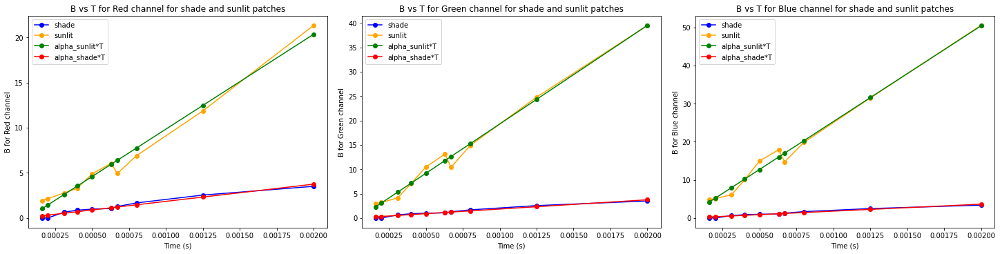

In [ ]:
B_shade = [B_shade_r, B_shade_g, B_shade_b]
B_sunlit = [B_sunlit_r, B_sunlit_g, B_sunlit_b]
alpha_sunlit = [y_sunlit_r, y_sunlit_g, y_sunlit_b]
alpha_shade = [y_shade_r, y_shade_g, y_shade_b]

plot_B(T, B_shade, B_sunlit, alpha_sunlit, alpha_shade)

Calculate alpha for each channel.

In [ ]:
alpha_shade_r = np.matmul(B_shade_r,T) / np.sum(np.square(T))
alpha_shade_g = np.matmul(B_shade_g,T) / np.sum(np.square(T))
alpha_shade_b = np.matmul(B_shade_b,T) / np.sum(np.square(T))

print("Alpha for Red, Green and Blue channel: {0:0.2f}, {1:0.2f}, and {2:0.2f}".format(alpha_shade_r, alpha_shade_g, alpha_shade_b))

Alpha for Red, Green and Blue channel: 1849.48, 1845.29, and 1804.42


In [ ]:
alpha_sunlit_r = np.matmul(B_sunlit_r,T) / np.sum(np.square(T))
alpha_sunlit_g = np.matmul(B_sunlit_g,T) / np.sum(np.square(T))
alpha_sunlit_b = np.matmul(B_sunlit_b,T) / np.sum(np.square(T))

print("Alpha for Red, Green and Blue channel: {0:0.2f}, {1:0.2f}, and {2:0.2f}".format(alpha_sunlit_r, alpha_sunlit_g, alpha_sunlit_b))

Alpha for Red, Green and Blue channel: 9908.41, 19363.12, and 25291.07


In [ ]:
K_r = alpha_sunlit_r / alpha_shade_r
K_g = alpha_sunlit_g / alpha_shade_g
K_b = alpha_sunlit_b / alpha_shade_b

print("K for Red, Green and Blue channel: {0:0.2f}, {1:0.2f}, and {2:0.2f}".format(K_r, K_g, K_b))

K for Red, Green and Blue channel: 5.36, 10.49, and 14.02


## Part 4: Relight

Set linearized image directory.

In [ ]:
linearized_images_dir = '/content/drive/MyDrive/CSE264-CV/Linearized-Images/'

Load linearized image files from the image directory.

NOTE: *It take some time to linearize all the images, so I preprocess them and save them to the google drive for future use.*

In [ ]:
def load_linearized_images_from_folder(folder):
  images = []
  image_list = []

  for x in os.listdir(folder):
    image_list.append((int)(x.split('.')[0]))

  image_list.sort()

  for filename in image_list:
    img_path = os.path.join(folder,str(filename)) + '.jpg'
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    if img is not None:
      images.append(img)

  return images, image_list

In [ ]:
linearized_images, linearized_image_list = load_linearized_images_from_folder(linearized_images_dir)

In [ ]:
print("Image shape:", linearized_images[0].shape)

Image shape: (1920, 1440, 3)


In [ ]:
print("Number of images:", len(linearized_images))
print("Image list:", linearized_image_list)

Number of images: 25
Image list: [10, 11, 13, 15, 20, 25, 30, 40, 50, 80, 90, 100, 160, 200, 250, 500, 800, 1250, 1500, 1600, 2000, 2500, 3200, 5000, 6400]


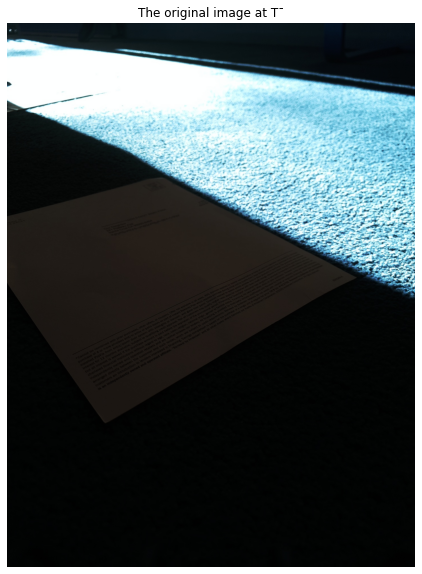

In [ ]:
plt.figure(figsize=(10,10))
plt.title('The original image at T¯')
plt.axis('off')
plt.imshow(linearized_images[9])

Compute 1/T (i.e. 1/F = T).

In [ ]:
T = linearized_image_list[::-1]

print("T:", T)

for i in range(len(T)):
  T[i] = round(1/T[i], 5)

print("1/T:", T)

T: [6400, 5000, 3200, 2500, 2000, 1600, 1500, 1250, 800, 500, 250, 200, 160, 100, 90, 80, 50, 40, 30, 25, 20, 15, 13, 11, 10]
1/T: [0.00016, 0.0002, 0.00031, 0.0004, 0.0005, 0.00063, 0.00067, 0.0008, 0.00125, 0.002, 0.004, 0.005, 0.00625, 0.01, 0.01111, 0.0125, 0.02, 0.025, 0.03333, 0.04, 0.05, 0.06667, 0.07692, 0.09091, 0.1]


Visualize cropping of the shaded area.

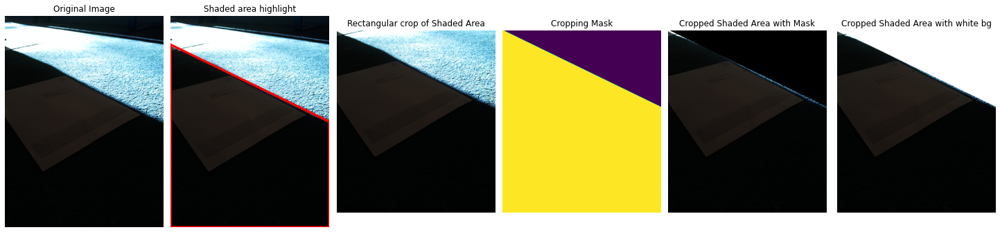

In [ ]:
img = linearized_images[9].copy()

x1 = 0
x2 = 1440
y1 = 260
y2 = 960
y3 = 1920
crop_shade_img = img.copy()

# Polygon corner points coordinates
pts = np.array([[x1, y1], [x2, y2],
                [x2, y2], [x2, y3],
                [x2, y3], [x1, y3],
                [x1, y3], [x1, y1]],
               np.int32)

pts = pts.reshape((-1, 1, 2))

highlight_shade_img = cv2.polylines(crop_shade_img, [pts], isClosed=True, color=(255,0,0), thickness=20)


# Crop the bounding rect
rect = cv2.boundingRect(pts)
x, y, w, h = rect
crop_shade_img = img[y:y+h, x:x+w].copy()

## make mask
pts = pts - pts.min(axis=0)

mask = np.zeros(crop_shade_img.shape[:2], np.uint8)
cv2.drawContours(mask, [pts], -1, (255, 255, 255), -1, cv2.LINE_AA)

# do bit-op
cropped_area_mask = cv2.bitwise_and(crop_shade_img, crop_shade_img, mask=mask)

# add the white background
bg = np.ones_like(crop_shade_img, np.uint8) * 255
cv2.bitwise_not(bg, bg, mask=mask)
cropped_area_white_bg = bg + cropped_area_mask

fig, (ax1, ax2, ax3, ax4, ax5, ax6) = plt.subplots(1, 6, constrained_layout=True, figsize=(20,20))

ax1.imshow(img)
ax1.axis('off')
ax1.title.set_text("Original Image")

ax2.imshow(highlight_shade_img)
ax2.axis('off')
ax2.title.set_text("Shaded area highlight")

ax3.imshow(crop_shade_img)
ax3.axis('off')
ax3.title.set_text("Rectangular crop of Shaded Area")

ax4.imshow(mask)
ax4.axis('off')
ax4.title.set_text("Cropping Mask")

ax5.imshow(cropped_area_mask)
ax5.axis('off')
ax5.title.set_text("Cropped Shaded Area with Mask")

ax6.imshow(cropped_area_white_bg)
ax6.axis('off')
ax6.title.set_text("Cropped Shaded Area with white bg")

plt.show()

Relight the shaded area using the same image.

In [ ]:
def relit_using_same(image, K_r=3.1, K_g=3.86, K_b=5.38):
  img = image.copy()

  x1 = 0
  x2 = 1440
  y1 = 260
  y2 = 960
  y3 = 1920

  # Polygon corner points coordinates
  pts = np.array([[x1, y1], [x2, y2],
                  [x2, y2], [x2, y3],
                  [x2, y3], [x1, y3],
                  [x1, y3], [x1, y1]],
                np.int32)

  pts = pts.reshape((-1, 1, 2))

  # Crop the bounding rect
  rect = cv2.boundingRect(pts)
  x, y, w, h = rect
  crop_shade_img = img[y:y+h, x:x+w].copy()

  ## make mask
  pts = pts - pts.min(axis=0)

  mask = np.zeros(crop_shade_img.shape[:2], np.uint8)
  cv2.drawContours(mask, [pts], -1, (255, 255, 255), -1, cv2.LINE_AA)

  # do bit-op
  cropped_area_mask = cv2.bitwise_and(crop_shade_img, crop_shade_img, mask=mask)
  cropped_area_mask[:,:,0] = cropped_area_mask[:,:,0]*K_r
  cropped_area_mask[:,:,1] = cropped_area_mask[:,:,1]*K_g
  cropped_area_mask[:,:,2] = cropped_area_mask[:,:,2]*K_b

  crop_area_rect = crop_shade_img + cropped_area_mask
  collage = img.copy()

  collage[y1:,:] = crop_area_rect

  return collage

In [ ]:
collage = relit_using_same(linearized_images[9])

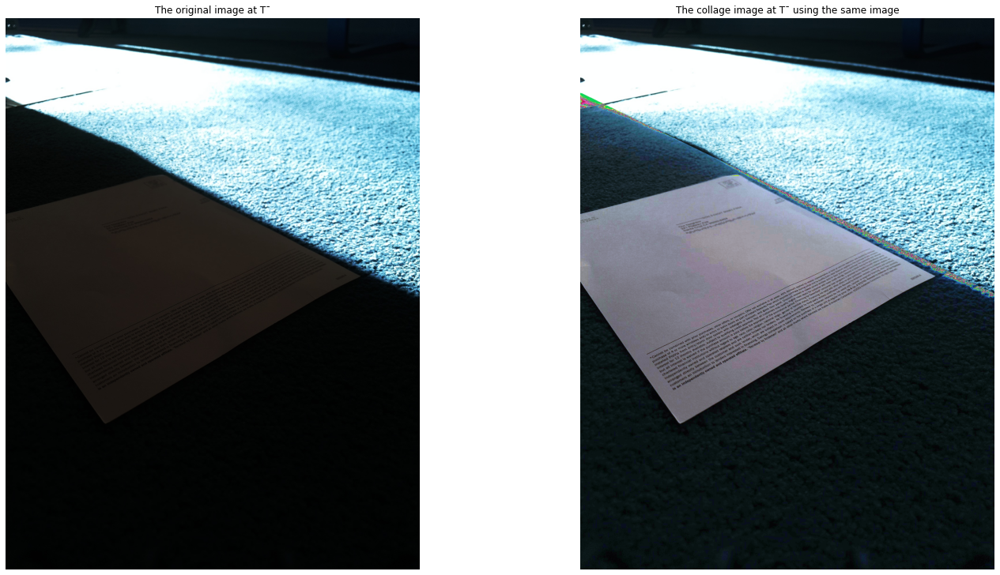

In [ ]:
fig, axes = plt.subplots(1, 2, constrained_layout=True, figsize=(20,10))

axes[0].imshow(linearized_images[9])
axes[0].axis('off')
axes[0].title.set_text('The original image at T¯')

axes[1].imshow(collage)
axes[1].axis('off')
axes[1].title.set_text('The collage image at T¯ using the same image')

plt.show()

Relight the shaded area using all the images.

In [ ]:
def relit_using_all(T, T_bar, images, K_r=26.78, K_g=30.78, K_b=32.78):
  sum_T = np.sum(T)
  wts = [t/sum_T for t in T]

  x1 = 0
  x2 = 1440
  y1 = 260
  y2 = 960
  y3 = 1920

  # Polygon corner points coordinates
  pts = np.array([[x1, y1], [x2, y2],
                  [x2, y2], [x2, y3],
                  [x2, y3], [x1, y3],
                  [x1, y3], [x1, y1]],
                np.int32)

  pts = pts.reshape((-1, 1, 2))

  # Crop the bounding rect
  rect = cv2.boundingRect(pts)
  x, y, w, h = rect

  img_T = images[T_bar].copy()
  crop_shade_img_T = img_T[y:y+h, x:x+w].copy()

  # make mask
  pts = pts - pts.min(axis=0)

  mask = np.zeros(crop_shade_img_T.shape[:2], np.uint8)
  cv2.drawContours(mask, [pts], -1, (255, 255, 255), -1, cv2.LINE_AA)

  # do bit-op
  cropped_area_mask_T = cv2.bitwise_and(crop_shade_img_T, crop_shade_img_T, mask=mask)

  for i, img in enumerate(images):
    crop_shade_img = img[y:y+h, x:x+w].copy()

    crop_shade_img = img[y:y+h, x:x+w].copy()

    mask = np.zeros(crop_shade_img.shape[:2], np.uint8)
    cv2.drawContours(mask, [pts], -1, (255, 255, 255), -1, cv2.LINE_AA)

    # do bit-op
    cropped_area_mask = cv2.bitwise_and(crop_shade_img, crop_shade_img, mask=mask)
    cropped_area_mask_T[:,:,0] = np.add(cropped_area_mask_T[:,:,0], cropped_area_mask[:,:,0] * (wts[i] * K_r * T[T_bar] / T[i]))
    cropped_area_mask_T[:,:,1] = np.add(cropped_area_mask_T[:,:,1], cropped_area_mask[:,:,1] * (wts[i] * K_g * T[T_bar] / T[i]))
    cropped_area_mask_T[:,:,2] = np.add(cropped_area_mask_T[:,:,2], cropped_area_mask[:,:,2] * (wts[i] * K_b * T[T_bar] / T[i]))

  crop_area_rect = crop_shade_img_T + cropped_area_mask_T
  collage = images[T_bar].copy()

  collage[y1:,:] = crop_area_rect

  return collage

In [ ]:
collage = relit_using_all(T, 9, linearized_images)

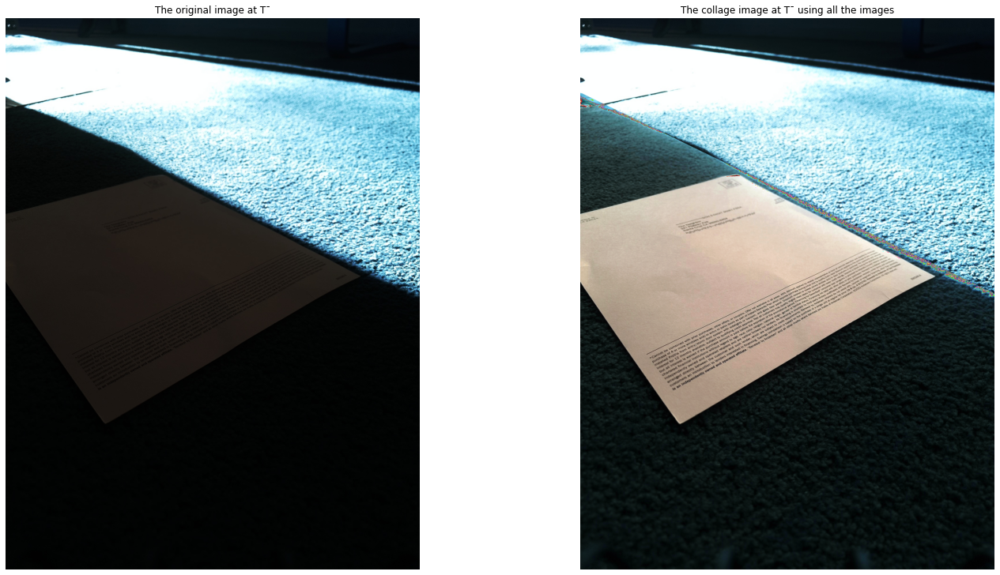

In [ ]:
fig, axes = plt.subplots(1, 2, constrained_layout=True, figsize=(20,10))

axes[0].imshow(linearized_images[9])
axes[0].axis('off')
axes[0].title.set_text('The original image at T¯')

axes[1].imshow(collage)
axes[1].axis('off')
axes[1].title.set_text('The collage image at T¯ using all the images')

plt.show()